# OWLSentimentAnalysis - Wordcloud
https://github.com/KavelCortex/OWLSentimentAnalysis

## Declare Environments

In [1]:
from config import teams
class Environment:
    pass
env = Environment()

env.data_dir = 'data'
env.logo_dir = 'logos'
env.team_list = teams

env.stopwords=['https','pic','twitter','twitch','OWL2019','overwatch','league','overwatchleague','team','game','play']


## Load Data

### Generate json path for each team

In [2]:
import os


def generate_team_file_path(team_list, team_data_dir):
    teams_path_dict = {}
    for root, dirs, files in os.walk(team_data_dir):
        teams_path_dict.update({
            team_name: [
                os.path.join(team_data_dir, file) for file in files
                if file.startswith(team_name)
            ]
            for team_name in team_list
        })
    return teams_path_dict


env.team_file_paths = generate_team_file_path(
    team_list=env.team_list, team_data_dir=env.data_dir)
env.team_file_paths

{'ATLReign': ['data/ATLReign_2019-02-14_2019-04-21.json'],
 'Boston Uprising': ['data/Boston Uprising_2019-02-14_2019-04-21.json'],
 'FLMayhem': ['data/FLMayhem_2019-02-14_2019-04-21.json'],
 'Houston Outlaws': ['data/Houston Outlaws_2019-02-14_2019-04-21.json'],
 'London Spitfire': ['data/London Spitfire_2019-02-14_2019-04-21.json'],
 'NYXL': ['data/NYXL_2019-02-14_2019-04-21.json'],
 'Paris Eternal': ['data/Paris Eternal_2019-02-14_2019-04-21.json'],
 'Philadelphia Fusion': ['data/Philadelphia Fusion_2019-02-14_2019-04-21.json'],
 'Toronto Defiant': ['data/Toronto Defiant_2019-02-14_2019-04-21.json'],
 'WashJustice': ['data/WashJustice_2019-02-14_2019-04-21.json'],
 'Chengdu Hunters': ['data/Chengdu Hunters_2019-02-14_2019-04-21.json'],
 'Dallas Fuel': ['data/Dallas Fuel_2019-02-14_2019-04-21.json'],
 'GZCharge': ['data/GZCharge_2019-02-14_2019-04-21.json'],
 'Hangzhou Spark': ['data/Hangzhou Spark_2019-02-14_2019-04-21.json'],
 'LAGladiators': ['data/LAGladiators_2019-02-14_2019-04-

### Declare functions for getting data by team name

In [3]:
import json
def get_data_by_team_name(team_name, team_file_paths):
    team_tweet_list = []
    for file_path in team_file_paths[team_name]:
        with open(file_path, 'r') as f:
            json_lines = [line.strip('\n') for line in f]
            json_dicts=[json.loads(json_line) for json_line in json_lines]
            team_tweet_list.extend(json_dicts)
    return team_tweet_list


t_list=get_data_by_team_name(team_name='Shanghai Dragons', team_file_paths=env.team_file_paths)
len(t_list)

19689

## Word Clouds

### Extract texts form tweets

In [4]:
import json
def extract_text_from_list(tweet_list):
    s=""
    for tweet in tweet_list:
        s+=tweet['text']
    return s

s=extract_text_from_list(t_list)
len(s)

1641514

### Generate wordcloud with mask

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from wordcloud import WordCloud, ImageColorGenerator,STOPWORDS


def wordcloud_image(team_name='Shanghai Dragons',
                    team_file_paths='',
                    show_img=True):
    mask = np.array(Image.open(os.path.join(env.logo_dir, team_name + '.png')))
    t_list = get_data_by_team_name(
        team_name=team_name, team_file_paths=team_file_paths)
    text = extract_text_from_list(t_list)
    image_colors = ImageColorGenerator(mask)
    wordcloud = WordCloud(stopwords=list(STOPWORDS)+env.stopwords+team_name.split(),
        background_color="white", mode="RGBA", max_words=1000,
        mask=mask).generate(text).recolor(color_func=image_colors)
    f, ax = plt.subplots(1, 2, figsize=[50, 50])
    ax[0].imshow(mask)
    ax[1].imshow(wordcloud, interpolation="bilinear")
    ax[0].axis("off")
    ax[1].axis("off")
    if show_img:
        plt.show()
    else:
        return wordcloud

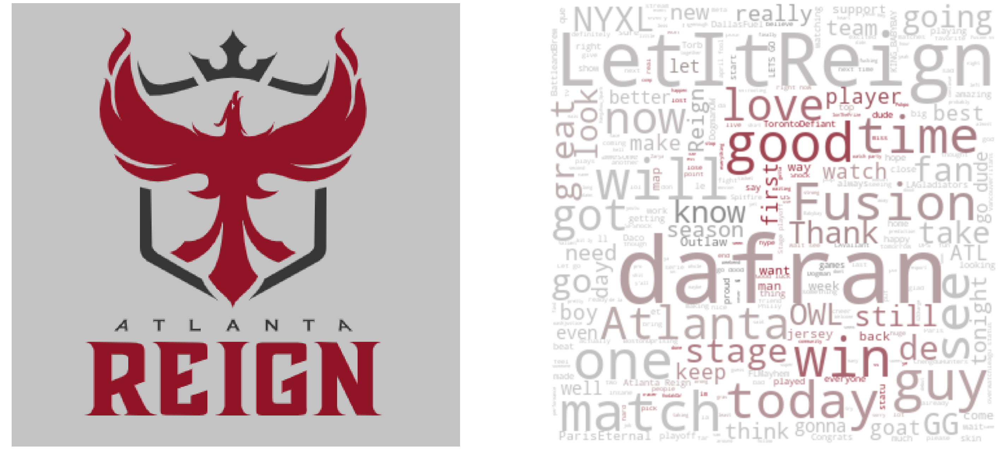

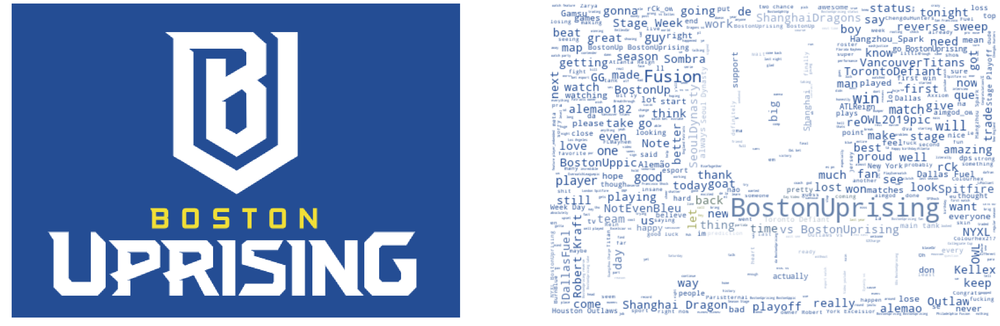

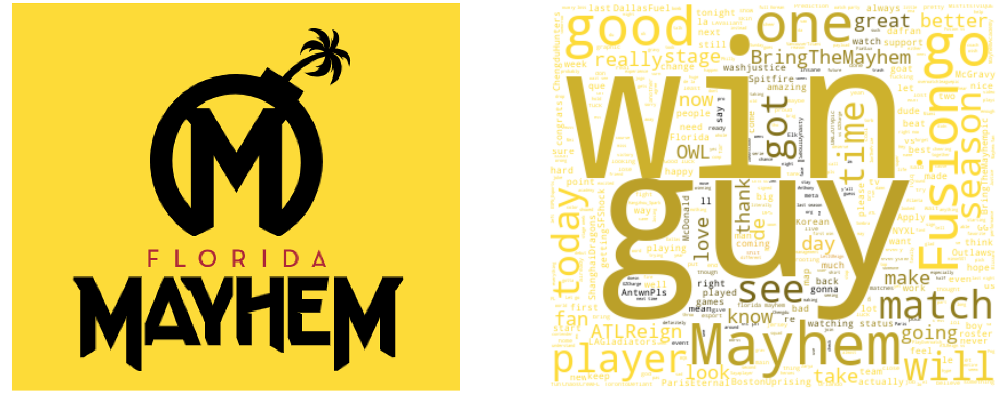

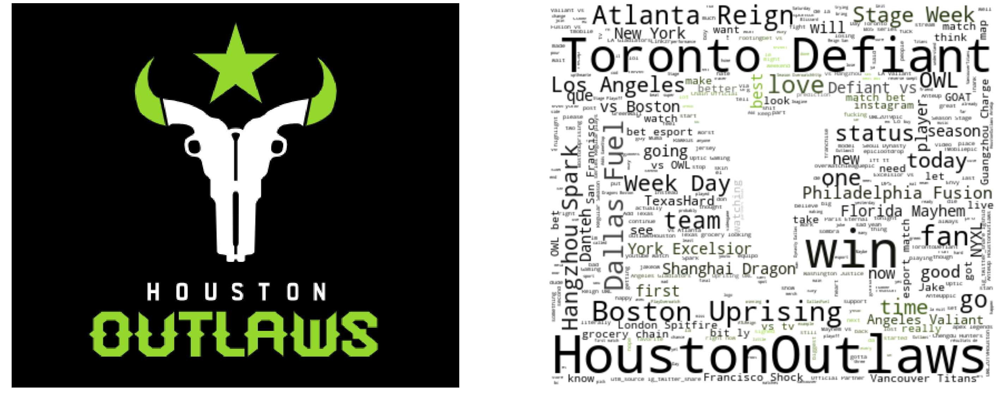

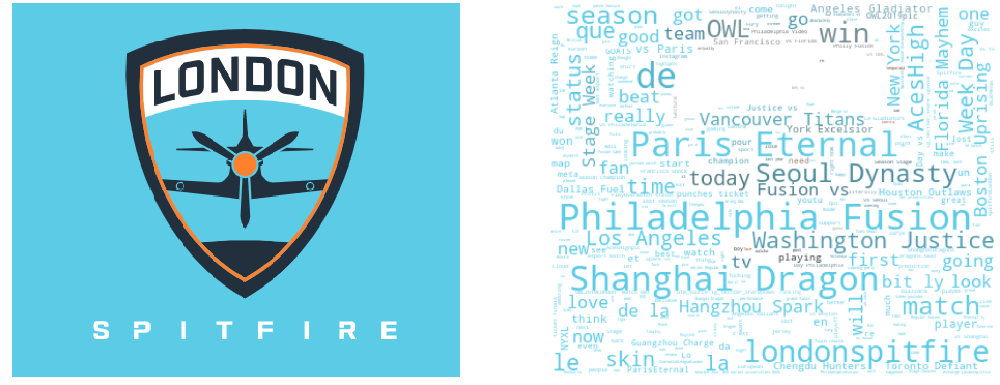

...

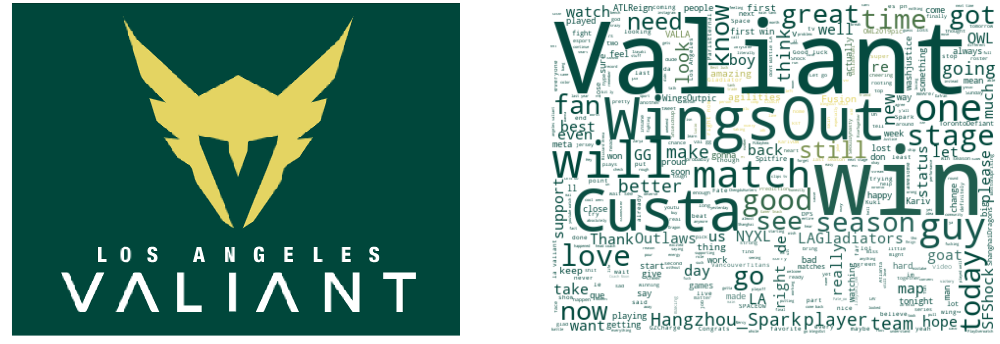

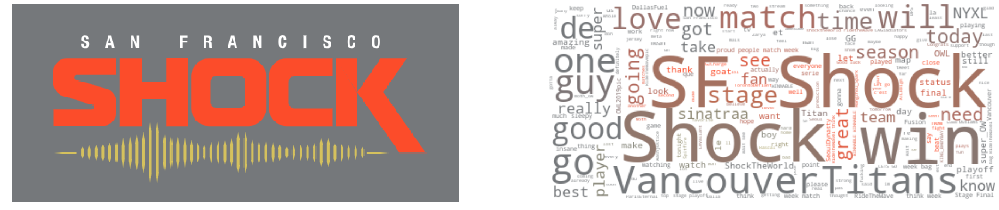

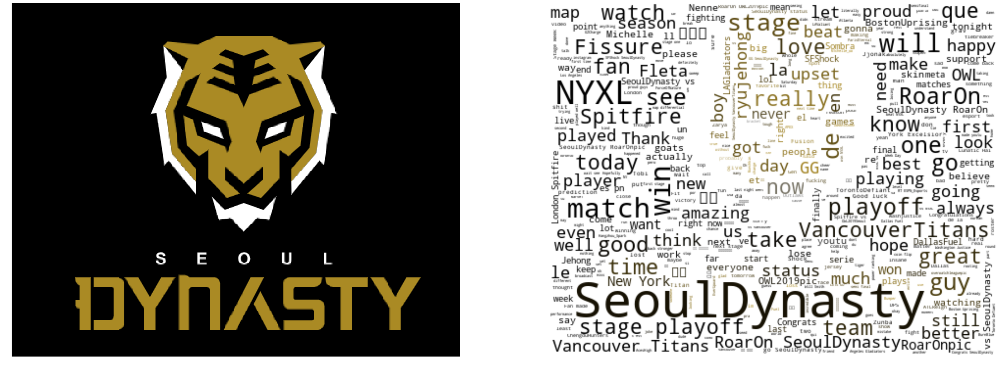

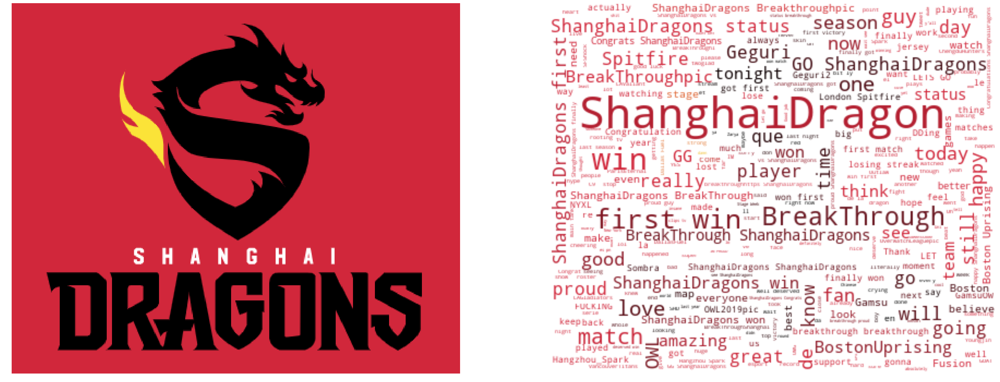

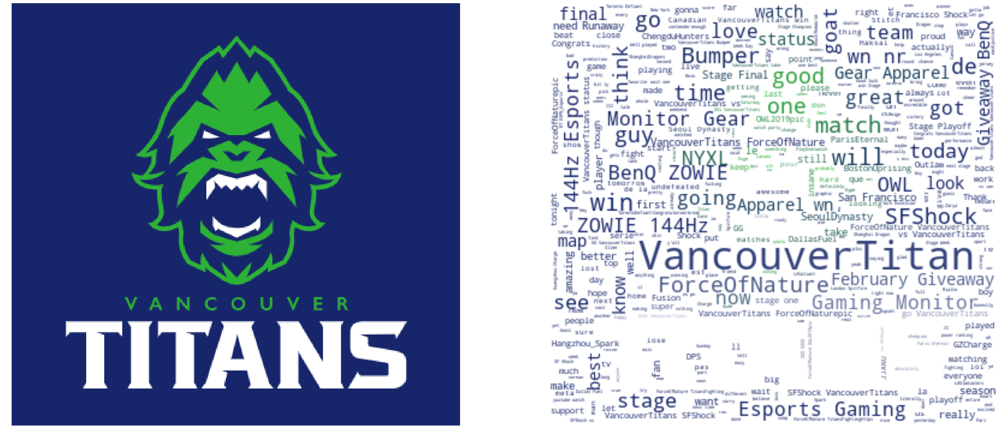

In [6]:
for t_name in env.team_list:
    wordcloud_image(
        team_name=t_name, team_file_paths=env.team_file_paths)